# ESSE 2220 – Lab 2 Report
## Part 2 - LED Battery Display

**Course:** ESSE 2220  
**Lab Title:** LED Battery Level Display with OOP Design  
**Date Performed:** 2025-09-26  
**Date Submitted:** 2025-09-26

---

## 1. Names & Group Info
**Group Number:** GROUP 5  
**Members:** Yathharthha Kaushal · Owen Oliver

---

## Setup

### Circuit Photo
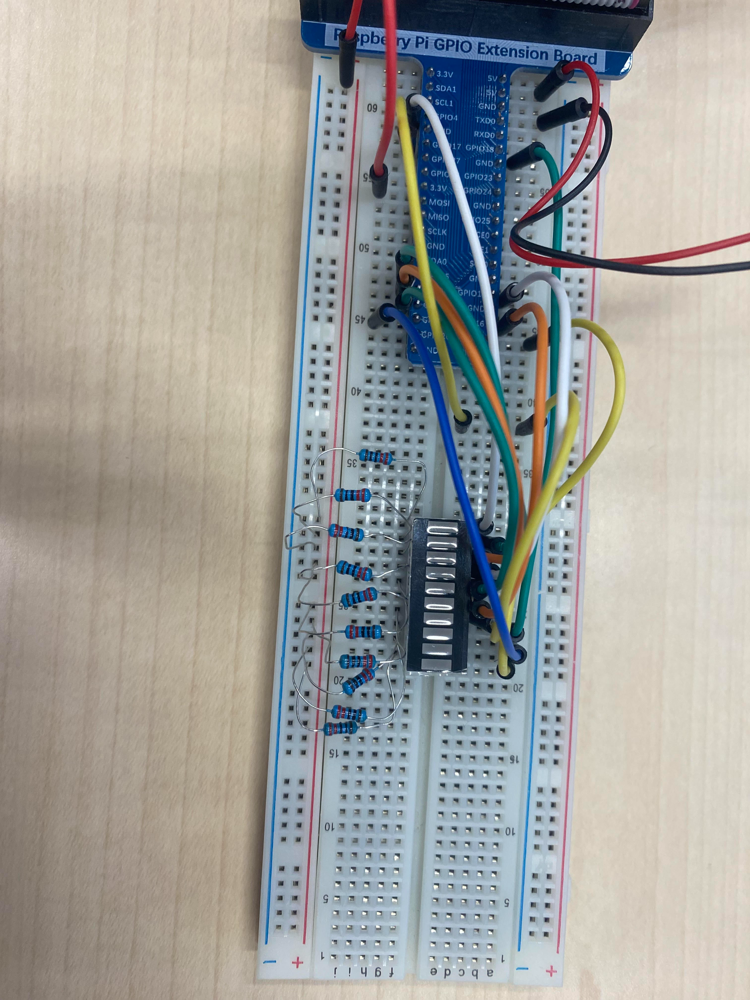

**GPIO Pins Used for LED Bar:** GPIO 4, 5, 6, 12, 13, 16, 17, 18, 19, 20

### Final Code

#### labReport2Part2.py (Main Program)

In [ ]:
import space_controller
import random
import time
import threading
import signal
import sys

simulation_running = True
battery_lock = threading.Lock()
ledDisplayObject = None

def signal_handler(signum, frame):
    global simulation_running
    print("Stopping simulation...")
    simulation_running = False

def battery_discharge_simulation():
    global simulation_running
    current_battery = 45
    
    print("Starting battery discharge simulation...")
    print("Press Ctrl+C to stop the simulation")
    
    while simulation_running and current_battery > 0:
        try:
            tickRate = 1.0
            random_tick_speed = random.uniform(0.5, 3.0) * tickRate
            battery_decrease = random.randint(1, 5)
            
            with battery_lock:
                current_battery = max(0, current_battery - battery_decrease)
                ledDisplayObject.setBatteryLevel(current_battery)
            
            print(f"Tick: {random_tick_speed:.2f}s | Battery decreased by {battery_decrease}% | Current: {current_battery}%")
            ledDisplayObject.updateLedStates()
            
            time.sleep(random_tick_speed)
            
        except space_controller.LEDDisplayError as e:
            print(f"LED Display error: {e}")
            break
        except Exception as e:
            print(f"Unexpected error: {e}")
            break
    
    print("Battery simulation completed!")

def main():
    global simulation_running, ledDisplayObject
    
    signal.signal(signal.SIGINT, signal_handler)
    
    try:
        with space_controller.LEDDisplay(
            batteryInput=100, 
            ledPinsArrStatus=[0]*10, 
            ledPinsArr=[4, 5, 6, 12, 13, 16, 17, 18, 19, 20]
        ) as ledDisplayObject:
            
            print("LED Display initialized successfully")
            
            ledDisplayObject.calculateLedStates()
            ledDisplayObject.updateLedStates()
            print("Initial state set")
            
            battery_thread = threading.Thread(target=battery_discharge_simulation)
            battery_thread.daemon = True
            battery_thread.start()
            
            while simulation_running and battery_thread.is_alive():
                time.sleep(0.1)
            
            if battery_thread.is_alive():
                print("Waiting for simulation thread to finish...")
                battery_thread.join(timeout=5.0)
            
    except space_controller.LEDDisplayError as e:
        print(f"LED Display initialization failed: {e}")
        sys.exit(1)
    except Exception as e:
        print(f"Unexpected error: {e}")
        sys.exit(1)
    finally:
        print("Simulation ended")

if __name__ == "__main__":
    main()


#### space_controller.py (LED Display Class)

In [ ]:
import RPi.GPIO as GPIO
import time
from typing import List

class LEDDisplayError(Exception):
    pass

class LEDDisplay:
    MIN_BATTERY = 0
    MAX_BATTERY = 100
    MIN_LEDS = 0
    MAX_LEDS = 10
    VALID_BCM_PINS = [2, 3, 4, 5, 6, 12, 13, 16, 17, 18, 19, 20, 21, 26]
    
    def __init__(self, batteryInput: float, ledPinsArrStatus: List[int], ledPinsArr: List[int]):
        self._validate_inputs(batteryInput, ledPinsArrStatus, ledPinsArr)
        
        self.batteryInput = batteryInput
        self.ledPinsArrStatus = ledPinsArrStatus
        self.ledPinsArr = ledPinsArr
        self.gpio_initialized = False
        
        self._initialize_gpio()
    
    def _validate_inputs(self, batteryInput: float, ledPinsArrStatus: List[int], ledPinsArr: List[int]):
        if not (self.MIN_BATTERY <= batteryInput <= self.MAX_BATTERY):
            raise LEDDisplayError(f"Battery level must be between {self.MIN_BATTERY} and {self.MAX_BATTERY}")
        if len(ledPinsArrStatus) != len(ledPinsArr):
            raise LEDDisplayError("ledPinsArrStatus and ledPinsArr must have the same length")
        if len(ledPinsArr) > self.MAX_LEDS:
            raise LEDDisplayError(f"Maximum {self.MAX_LEDS} LEDs supported")
        for pin in ledPinsArr:
            if pin not in self.VALID_BCM_PINS:
                raise LEDDisplayError(f"Invalid GPIO pin {pin}")
        if len(set(ledPinsArr)) != len(ledPinsArr):
            raise LEDDisplayError("Duplicate GPIO pins not allowed")
    
    def _initialize_gpio(self):
        try:
            GPIO.setmode(GPIO.BCM)
            GPIO.setwarnings(False)
            for pin in self.ledPinsArr:
                GPIO.setup(pin, GPIO.OUT)
                GPIO.output(pin, GPIO.LOW)
            self.gpio_initialized = True
        except Exception as e:
            raise LEDDisplayError(f"GPIO initialization failed: {e}")
    
    def __enter__(self):
        return self
    
    def __exit__(self, exc_type, exc_val, exc_tb):
        self.cleanup()
        return False
    
    def getCurrentBattery(self) -> float:
        return self.batteryInput

    def mapValues(self, inputValues: float, minInput: float, maxInput: float, minOut: float, maxOut: float) -> float:
        if maxInput == 0 or maxInput <= minInput:
            raise LEDDisplayError("Invalid input range")
        inputValues = max(minInput, min(maxInput, inputValues))
        mapped_value = ((inputValues - minInput) / (maxInput - minInput)) * (maxOut - minOut) + minOut
        return max(minOut, min(maxOut, mapped_value))

    def calculateLedStates(self):
        try:
            if self.batteryInput == 0:
                ledsToEnable = 0
            else:
                ledsToEnable = max(1, int(self.mapValues(
                    self.getCurrentBattery(), 
                    self.MIN_BATTERY, 
                    self.MAX_BATTERY, 
                    self.MIN_LEDS, 
                    len(self.ledPinsArrStatus)
                )))
            
            for i in range(len(self.ledPinsArrStatus)):
                self.ledPinsArrStatus[i] = 1 if i < ledsToEnable else 0
                
        except Exception as e:
            raise LEDDisplayError(f"Failed to calculate LED states: {e}")

    def setBatteryLevel(self, newLevel: float) -> float:
        try:
            if not isinstance(newLevel, (int, float)):
                raise LEDDisplayError("Battery level must be a number")
            
            old_level = self.batteryInput
            self.batteryInput = max(self.MIN_BATTERY, min(self.MAX_BATTERY, newLevel))
            
            if self.batteryInput != old_level:
                self.calculateLedStates()
                if self.batteryInput <= 15 and old_level > 15:
                    self.triggerLowBatteryWarning()
            
            return self.batteryInput
            
        except Exception as e:
            raise LEDDisplayError(f"Failed to set battery level: {e}")

    def updateLedStates(self):
        if not self.gpio_initialized:
            raise LEDDisplayError("GPIO not initialized")
        
        try:
            for i, pin in enumerate(self.ledPinsArr):
                if i < len(self.ledPinsArrStatus):
                    GPIO.output(pin, GPIO.HIGH if self.ledPinsArrStatus[i] == 0 else GPIO.LOW)
                        
        except Exception as e:
            raise LEDDisplayError(f"Failed to update LED states: {e}")
    
    def cleanup(self):
        if self.gpio_initialized:
            try:
                for pin in self.ledPinsArr:
                    GPIO.output(pin, GPIO.LOW)
                GPIO.cleanup()
                self.gpio_initialized = False
            except Exception:
                pass
    def triggerLowBatteryWarning(self):
        if not self.gpio_initialized or len(self.ledPinsArr) == 0:
            return
            
        try:
            blinks = 3
            timeBetweenBlinks = 0.01
            timeOfBlink = 0.2
            for i in range(blinks):
                for pin in self.ledPinsArr:
                    GPIO.output(pin, GPIO.HIGH)
                time.sleep(timeOfBlink)
                for pin in self.ledPinsArr:
                    GPIO.output(pin, GPIO.LOW)
                time.sleep(timeBetweenBlinks)
        except Exception:
            pass

---

## Demo
**TA/Instructor Verification:** ✔️ Completed  

---

## Observations

### Lighting Style Design
**Style:** Progressive LED Bar Display

**Logic:** The lighting system uses a linear mapping approach where:
- Battery level (0-100%) is mapped to the number of active LEDs (0-10)
- LEDs turn on sequentially from left to right as battery increases
- LEDs turn off from right to left as battery decreases
- At least 1 LED remains on until battery reaches 0%

### LED Behavior with Battery Changes
**Battery Level → Number of LEDs:**
- 100% → 10 LEDs (all on)
- 90% → 9 LEDs
- 80% → 8 LEDs
- ...
- 10% → 1 LED
- 0% → 0 LEDs (all off)

**Special Features:**
- Low battery warning: All LEDs blink 3 times rapidly when battery drops to 15%
- Smooth transitions: LEDs update immediately when battery level changes
- Thread-safe updates: Battery level changes are protected by locks

---

## Analysis

### Function/Method Explanations

#### Main Program Functions (labReport2Part2.py)

**`signal_handler(signum, frame)`**
- **Receives:** Signal number and frame (from system)
- **Does:** Sets global flag to stop simulation gracefully
- **Returns:** Nothing (void)

**`battery_discharge_simulation()`**
- **Receives:** Nothing (accesses global variables)
- **Does:** Runs continuous loop simulating battery discharge with random timing and decreases, updates LED display
- **Returns:** Nothing (void)

**`main()`**
- **Receives:** Nothing
- **Does:** Initializes LED display system, starts simulation thread, handles cleanup
- **Returns:** Nothing (void)

#### LEDDisplay Class Methods (space_controller.py)

**`__init__(batteryInput, ledPinsArrStatus, ledPinsArr)`**
- **Receives:** Initial battery level, LED status array, GPIO pin array
- **Does:** Validates inputs, initializes GPIO pins, sets up object state
- **Returns:** New LEDDisplay instance

**`getCurrentBattery()`**
- **Receives:** Nothing (self)
- **Does:** Returns current battery level
- **Returns:** Float (battery percentage)

**`mapValues(inputValues, minInput, maxInput, minOut, maxOut)`**
- **Receives:** Value to map and input/output range parameters
- **Does:** Maps value from one range to another using linear interpolation
- **Returns:** Float (mapped value)

**`calculateLedStates()`**
- **Receives:** Nothing (uses object state)
- **Does:** Calculates which LEDs should be on based on current battery level
- **Returns:** Nothing (updates internal LED status array)

**`setBatteryLevel(newLevel)`**
- **Receives:** New battery percentage (float)
- **Does:** Updates battery level, recalculates LED states, triggers low battery warning if needed
- **Returns:** Float (actual battery level set)

**`updateLedStates()`**
- **Receives:** Nothing (uses object state)
- **Does:** Updates physical GPIO pins to match calculated LED states
- **Returns:** Nothing (void)

**`triggerLowBatteryWarning()`**
- **Receives:** Nothing (self)
- **Does:** Flashes all LEDs 3 times quickly to indicate low battery
- **Returns:** Nothing (void)

**`cleanup()`**
- **Receives:** Nothing (self)
- **Does:** Turns off all LEDs and releases GPIO resources
- **Returns:** Nothing (void)

### Class vs Functions Approach

**Why we used a class (LEDDisplay):**

1. **State Management:** The class encapsulates battery level, LED states, and GPIO configuration in one object
2. **Data Validation:** Constructor validates all inputs before creating the object
3. **Resource Management:** Context manager (`__enter__`/`__exit__`) ensures proper GPIO cleanup
4. **Encapsulation:** Internal methods like `_validate_inputs()` and `_initialize_gpio()` are hidden from external use
5. **Reusability:** Multiple LED displays could be created with different configurations
6. **Error Handling:** Custom exception class provides specific error types

**Advantages gained:**
- **Cleaner Code:** Related functionality is grouped together
- **Better Organization:** Clear separation between simulation logic and hardware control
- **Easier Testing:** Individual methods can be tested independently
- **Maintainability:** Changes to LED behavior are contained within the class
- **Extensibility:** New features (like different lighting patterns) can be added as methods

---

## Bonus

### Low Battery Warning Implementation
**Feature:** Automatic low battery warning when battery drops to 15%

**Implementation Details:**
- Triggers automatically when `setBatteryLevel()` detects battery crossing 15% threshold
- Flashes all LEDs 3 times rapidly (0.2s on, 0.01s off)
- Non-blocking: warning doesn't interfere with normal operation
- Only triggers once when crossing threshold (not every update below 15%)

**Code Location:** `triggerLowBatteryWarning()` method in LEDDisplay class

### Additional Features Implemented
- **Error Handling:** Custom exception class with specific error messages
- **Input Validation:** Comprehensive validation of GPIO pins, battery levels, and array sizes
- **Context Manager:** Automatic cleanup using Python's `with` statement
- **Signal Handling:** Graceful shutdown on Ctrl+C

---

## Conclusion
Using threading instead of time.sleep for delays made this more usable for actual space mission battery displays, since using time.sleep() puts the entire program to sleep - in a real space mission that would put the entire mainframe to sleep - while the program is sleeping - no sensor inputs, no communications, all operations are paused until the time.sleep() delay is used. However, by using threads instead of time.sleep() this lets just one thread wait for the delay in the background, while the program is free to do other things at the same time.

---

**End of Report**